# Predicting House Sale Prices
### A Dataquest.io Guided Project

In this project, we apply the concepts learned about linear regresson for machine learning using the Ames housing dataset from 2006-2010. The techniques and conepts applied in this project include:
- Building intuition for model-based learning
- Explore how the Linear Regression model works as used in Scikit Learn
- Explore the two different approaches for model fitting
- Utilize techniques for selecting, cleaning, and transforming features

In [40]:
import numpy as np
import pandas as pd
import altair as alt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.impute import SimpleImputer

In [41]:
data = pd.read_csv('data/AmesHousing.tsv', sep='\t')
data.shape

(2930, 82)

In [ ]:
# make a copy of data for general experimentation

## Examine and Clean Data
Missing values per column. We are using 5% as the cutoff for now.

In [3]:
na_counts = data.isnull().mean()
cols_with_too_many_na_values = data.columns[data.isnull().mean() > 0.05]
cols_with_too_many_na_values

Index(['Lot Frontage', 'Alley', 'Fireplace Qu', 'Garage Type', 'Garage Yr Blt',
       'Garage Finish', 'Garage Qual', 'Garage Cond', 'Pool QC', 'Fence',
       'Misc Feature'],
      dtype='object')

Columns with less than 5% missing data. The models do not like missing data. We can either drop or impute. Since these columns are mostly complete, it would be waste to drop them.

A lot of these columns are related to the basement. Let's check if these particular nulls count toward a no basement value.

In [4]:
cols_little_na_values = data.columns[(data.isnull().mean() <= 0.05) & data.isnull().sum() > 0]
print(cols_little_na_values.value_counts())
print(data[cols_little_na_values].dtypes)

Bsmt Unf SF       1
Electrical        1
Mas Vnr Area      1
BsmtFin SF 2      1
BsmtFin SF 1      1
Mas Vnr Type      1
BsmtFin Type 2    1
Bsmt Exposure     1
Garage Area       1
Garage Cars       1
Total Bsmt SF     1
dtype: int64
Mas Vnr Type       object
Mas Vnr Area      float64
Bsmt Exposure      object
BsmtFin SF 1      float64
BsmtFin Type 2     object
BsmtFin SF 2      float64
Bsmt Unf SF       float64
Total Bsmt SF     float64
Electrical         object
Garage Cars       float64
Garage Area       float64
dtype: object


In [5]:
bsmt = ['Bsmt Qual', 'BsmtFin SF 1', 'BsmtFin SF 2', 'Bsmt Unf SF', 'Total Bsmt SF']
data[bsmt][data['Bsmt Qual'].isna()].mean()

Bsmt Qual        NaN
BsmtFin SF 1     0.0
BsmtFin SF 2     0.0
Bsmt Unf SF      0.0
Total Bsmt SF    0.0
dtype: float64

The NA values for the basement measurements all seem to be the result of no basement. Therefore it's probably best to fill those in with a zero.

In [6]:
data[data['Mas Vnr Area'].isnull()][['Mas Vnr Type', 'Mas Vnr Area']].mean()
data['Mas Vnr Type'].value_counts()

None       1752
BrkFace     880
Stone       249
BrkCmn       25
CBlock        1
Name: Mas Vnr Type, dtype: int64

Likewise, an NA area also means the absence of that particular feature.

Note that the *None* is not the data type of `None` in Python, but an actual value instead. Very confusing. For any NA values for these fields, they should be filled in with an appropriate *None* value where applicable if we decide to use any of these features. If.

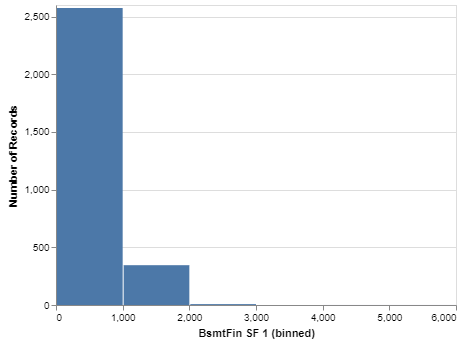

In [21]:
alt.Chart(data).mark_bar().encode(
    alt.X("BsmtFin SF 1:Q", bin=True),
    y='count()',
)

In [45]:
#ipu = SimpleImputer(missing_values=np.nan, strategy='mean')
print(ipu.fit_transform(data[['BsmtFin SF 1', 'BsmtFin SF 2']]))


[[ 639.    0.]
 [ 468.  144.]
 [ 923.    0.]
 ...
 [ 337.    0.]
 [1071.  123.]
 [ 758.    0.]]


### Examine Numerical Columns
This is a lot of data. We'll split our analysis by looking at just the numerical data and see what it looks like.

In [19]:
data.select_dtypes(include='number').columns

Index(['Order', 'PID', 'MS SubClass', 'Lot Frontage', 'Lot Area',
       'Overall Qual', 'Overall Cond', 'Year Built', 'Year Remod/Add',
       'Mas Vnr Area', 'BsmtFin SF 1', 'BsmtFin SF 2', 'Bsmt Unf SF',
       'Total Bsmt SF', '1st Flr SF', '2nd Flr SF', 'Low Qual Fin SF',
       'Gr Liv Area', 'Bsmt Full Bath', 'Bsmt Half Bath', 'Full Bath',
       'Half Bath', 'Bedroom AbvGr', 'Kitchen AbvGr', 'TotRms AbvGrd',
       'Fireplaces', 'Garage Yr Blt', 'Garage Cars', 'Garage Area',
       'Wood Deck SF', 'Open Porch SF', 'Enclosed Porch', '3Ssn Porch',
       'Screen Porch', 'Pool Area', 'Misc Val', 'Mo Sold', 'Yr Sold',
       'SalePrice'],
      dtype='object')

Several columns, while numeric, are not a good fit as features due to what those numbers really meant. `Order` and `PID` are more like ID numbers that don't have relation to the rest of the data, and should be dropped.

The following columns are either categorical or ordinal data:
- MS SubClass
- Overall Qual
- Overall Cond
- Year Built
- Year Remod/Add
- Garage Yr Blt
- Mo Sold
- Yr Sold

In [42]:
data = data.drop(['Order', 'PID'], axis=1)

data['MS SubClass'] = data['MS SubClass'].astype('category')

In [43]:
data.corrwith(data['SalePrice']).sort_values()

Enclosed Porch    -0.128787
Kitchen AbvGr     -0.119814
Overall Cond      -0.101697
Low Qual Fin SF   -0.037660
Bsmt Half Bath    -0.035835
Yr Sold           -0.030569
Misc Val          -0.015691
BsmtFin SF 2       0.005891
3Ssn Porch         0.032225
Mo Sold            0.035259
Pool Area          0.068403
Screen Porch       0.112151
Bedroom AbvGr      0.143913
Bsmt Unf SF        0.182855
Lot Area           0.266549
2nd Flr SF         0.269373
Bsmt Full Bath     0.276050
Half Bath          0.285056
Open Porch SF      0.312951
Wood Deck SF       0.327143
Lot Frontage       0.357318
BsmtFin SF 1       0.432914
Fireplaces         0.474558
TotRms AbvGrd      0.495474
Mas Vnr Area       0.508285
Garage Yr Blt      0.526965
Year Remod/Add     0.532974
Full Bath          0.545604
Year Built         0.558426
1st Flr SF         0.621676
Total Bsmt SF      0.632280
Garage Area        0.640401
Garage Cars        0.647877
Gr Liv Area        0.706780
Overall Qual       0.799262
SalePrice          1

### Feature Engineering
There are additional features we can create from this data. One example would be the years until remodel feature that was covered in the lessons.

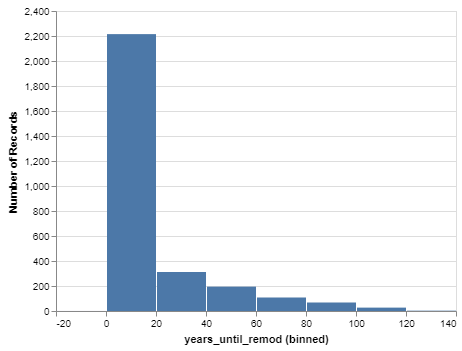

In [12]:
data['years_until_remod'] = data['Year Remod/Add'] - data['Year Built']
alt.Chart(data).mark_bar().encode(
    alt.X("years_until_remod:Q", bin=True),
    y='count()',
)

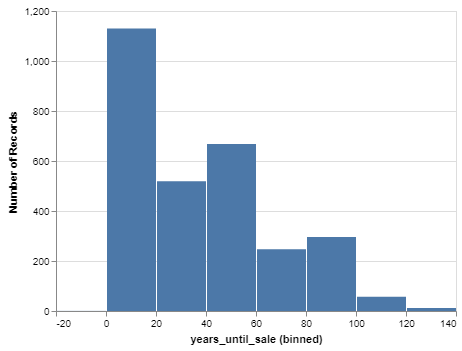

In [75]:
data['years_until_sale'] = data['Yr Sold'] - data['Year Built']
alt.Chart(data).mark_bar().encode(
    alt.X("years_until_sale:Q", bin=True),
    y='count()',
)

In [5]:
'''
This function will:
 - remove features not wanted in model based on % missing values or data leakage
 - transform features into proper format
 - create new features by combining features
'''
def transform_features(train):
    train = data.copy(train)
    
    # drop columns that have no relation to our target
    train = train.drop(['Order', 'PID'], axis=1)
    # drop columns that may leak information about the sale itself
    train = train.drop('Sale Condition', axis=1)
    # drop columns with too many NA values
    train = train.drop(data.columns[data.isnull().mean() > 0.05], axis=1)
    
    # impute columns with missing values
    train['Mas Vnr Area'] = imp.transform(train['Mas Vnr Area'])
    # impute columns with missing values as a 0
    zero_cols = ['BsmtFin SF 1', 'BsmtFin SF 2', 'Bsmt Unf SF', 'Total Bsmt SF', 'Mas Vnr Area']
    imp_z = SimpleImputer(missing_values=np.nan, strategy='constant' fill_value=0)
    train[zero_cols] = imp_z.fit_transform(train[zero_cols])
    
    # dtype conversions
    train['MS Sub Class'] = train['MS Sub Class'].astype('category')
    
    # new features + dropping columns if not needed
    train['years_until_remod'] = train['Year Remod/Add'] - train['Year Built']
    train['years_until_sale'] = train['Yr Sold'] - train['Year Built']
    
    train = train.drop(['Year Remod/Add', 'Year Built', 'Yr Sold', 'Mo Sold'])
    
    # drop columns with low correlation to SalePrice
    return train

In [6]:
def select_features(train):
    return train[['Gr Liv Area', 'SalePrice']]

In [7]:
def train_and_test():
    data = pd.read_csv('data/AmesHousing.tsv', sep='\t')
    train = data[:1460]
    test = data[1461:]
    
    t_train = transform_features(train)
    
    train_X = select_features(train)
    y = train_X['SalePrice']
    train_X = train_X.drop('SalePrice', axis=1)
    #print(train_X.columns)
    reg = LinearRegression().fit(train_X, y)
    predicts = reg.predict(train_X)
    
    return mean_squared_error(y, predicts)**0.5

In [8]:
train_and_test(data)

56034.362001412796